# Personal Key Indicators of Heart Disease

In [ ]:
import seaborn as sns
import numpy as np 
import pandas as pd 
from matplotlib import pyplot as plt
import plotly.express as px
from pandas.plotting import scatter_matrix


In [ ]:
data = pd.read_csv('/content/drive/MyDrive/diplomska/heart_2020_cleaned.csv')
data.head()

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
0,No,16.60,Yes,No,No,3.0,30.0,No,Female,55-59,White,Yes,Yes,Very good,5.0,Yes,No,Yes
1,No,20.34,No,No,Yes,0.0,0.0,No,Female,80 or older,White,No,Yes,Very good,7.0,No,No,No
2,No,26.58,Yes,No,No,20.0,30.0,No,Male,65-69,White,Yes,Yes,Fair,8.0,Yes,No,No
3,No,24.21,No,No,No,0.0,0.0,No,Female,75-79,White,No,No,Good,6.0,No,No,Yes
4,No,23.71,No,No,No,28.0,0.0,Yes,Female,40-44,White,No,Yes,Very good,8.0,No,No,No


In [ ]:
data.shape

(319795, 18)



## Испитување на структурата на податочното множество и разгледување на колони во кои има нул вредности

#### Нул вредности во колоните

In [ ]:
7#null vrednosti
data.isnull().any()

HeartDisease        False
BMI                 False
Smoking             False
AlcoholDrinking     False
Stroke              False
PhysicalHealth      False
MentalHealth        False
DiffWalking         False
Sex                 False
AgeCategory         False
Race                False
Diabetic            False
PhysicalActivity    False
GenHealth           False
SleepTime           False
Asthma              False
KidneyDisease       False
SkinCancer          False
dtype: bool

In [ ]:
data.isnull().sum()

HeartDisease        0
BMI                 0
Smoking             0
AlcoholDrinking     0
Stroke              0
PhysicalHealth      0
MentalHealth        0
DiffWalking         0
Sex                 0
AgeCategory         0
Race                0
Diabetic            0
PhysicalActivity    0
GenHealth           0
SleepTime           0
Asthma              0
KidneyDisease       0
SkinCancer          0
dtype: int64

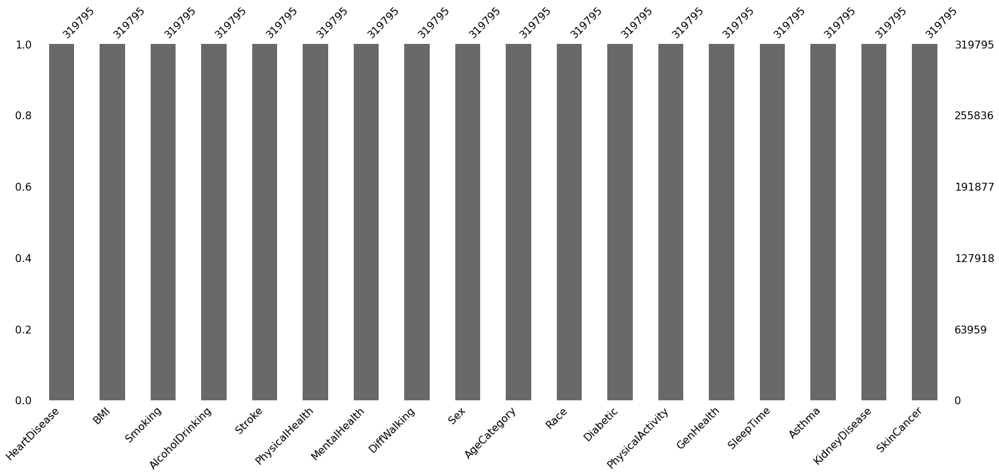

In [ ]:
import missingno as msno
msno.bar(data)

#### Општи информации за податочното множество

In [ ]:
#opsti informacii za mnozestvoto
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 319795 entries, 0 to 319794
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   HeartDisease      319795 non-null  object 
 1   BMI               319795 non-null  float64
 2   Smoking           319795 non-null  object 
 3   AlcoholDrinking   319795 non-null  object 
 4   Stroke            319795 non-null  object 
 5   PhysicalHealth    319795 non-null  float64
 6   MentalHealth      319795 non-null  float64
 7   DiffWalking       319795 non-null  object 
 8   Sex               319795 non-null  object 
 9   AgeCategory       319795 non-null  object 
 10  Race              319795 non-null  object 
 11  Diabetic          319795 non-null  object 
 12  PhysicalActivity  319795 non-null  object 
 13  GenHealth         319795 non-null  object 
 14  SleepTime         319795 non-null  float64
 15  Asthma            319795 non-null  object 
 16  KidneyDisease     31

In [ ]:
# unikatni vrednosti po kolona, se so cel da vidam dali object objektite moze da gi konvetiram vo brojni vrednosti
data.nunique()

HeartDisease           2
BMI                 3604
Smoking                2
AlcoholDrinking        2
Stroke                 2
PhysicalHealth        31
MentalHealth          31
DiffWalking            2
Sex                    2
AgeCategory           13
Race                   6
Diabetic               4
PhysicalActivity       2
GenHealth              5
SleepTime             24
Asthma                 2
KidneyDisease          2
SkinCancer             2
dtype: int64

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Детална обработка на вредностите во сите колони од податочното множество

## Детална обработка на сите колони т.е. видот на вредности внатре во нив

#### Анализа на карактеристиките со нумеричички вредности


In [ ]:
#opis na brojnite koloni t.e. na numerickite koloni
data.describe().T

,count,mean,std,min,25%,50%,75%,max
BMI,319795.0,28.325399,6.356100,12.02,24.03,27.34,31.42,94.85
PhysicalHealth,319795.0,3.371710,7.950850,0.00,0.00,0.00,2.00,30.00
MentalHealth,319795.0,3.898366,7.955235,0.00,0.00,0.00,3.00,30.00
SleepTime,319795.0,7.097075,1.436007,1.00,6.00,7.00,8.00,24.00


In [ ]:
#opis na site koloni i numericki i objekt 
data.describe(include=['number','object'])

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
count,319795,319795.000000,319795,319795,319795,319795.00000,319795.000000,319795,319795,319795,319795,319795,319795,319795,319795.000000,319795,319795,319795
unique,2,NaN,2,2,2,NaN,NaN,2,2,13,6,4,2,5,NaN,2,2,2
top,No,NaN,No,No,No,NaN,NaN,No,Female,65-69,White,No,Yes,Very good,NaN,No,No,No
freq,292422,NaN,187887,298018,307726,NaN,NaN,275385,167805,34151,245212,269653,247957,113858,NaN,276923,308016,289976
mean,NaN,28.325399,NaN,NaN,NaN,3.37171,3.898366,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.097075,NaN,NaN,NaN
std,NaN,6.356100,NaN,NaN,NaN,7.95085,7.955235,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.436007,NaN,NaN,NaN
min,NaN,12.020000,NaN,NaN,NaN,0.00000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN
25%,NaN,24.030000,NaN,NaN,NaN,0.00000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.000000,NaN,NaN,NaN
50%,NaN,27.340000,NaN,NaN,NaN,0.00000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.000000,NaN,NaN,NaN
75%,NaN,31.420000,NaN,NaN,NaN,2.00000,3.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.000000,NaN,NaN,NaN


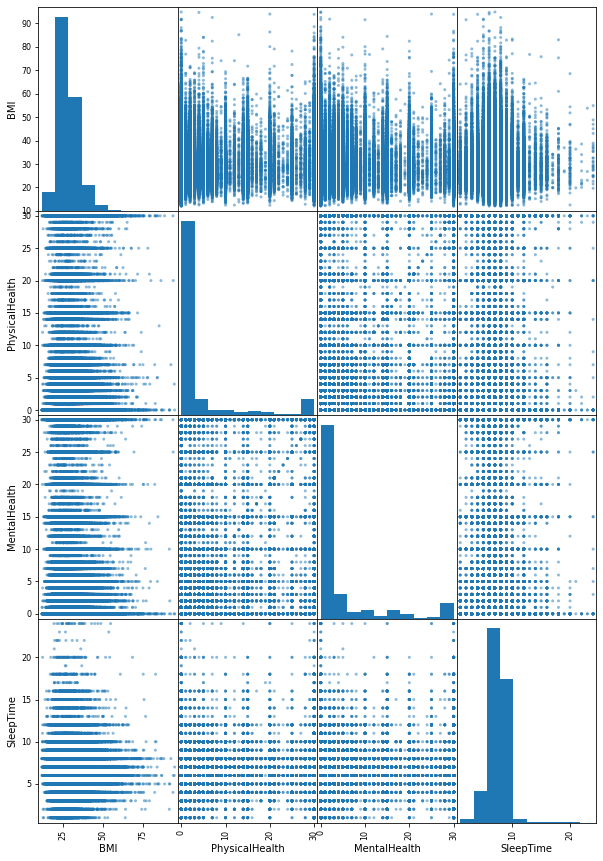

In [ ]:
names = data.columns
scatter_matrix(data, figsize=(10, 15))
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


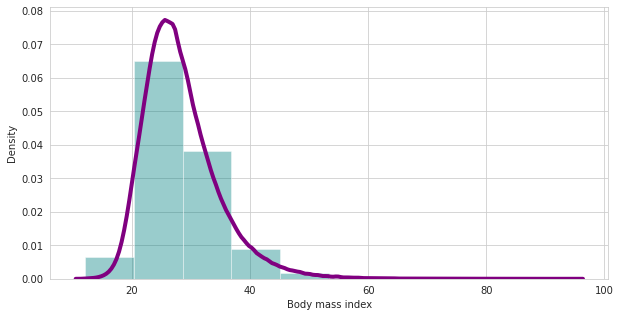

In [ ]:
sns.set_style("whitegrid") 
plt.figure(figsize = (10,5)) 
p=sns.distplot(x = data.BMI  , label='BMI',  bins = 10 , kde = True , color = 'teal'\
             , kde_kws=dict(linewidth = 4 , color = 'purple'))
p.set_xlabel("Body mass index")

plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


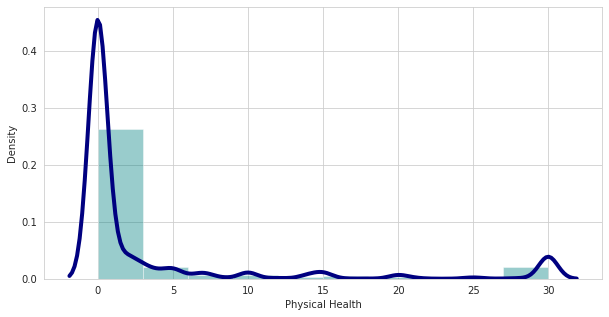

In [ ]:
sns.set_style("whitegrid") 
plt.figure(figsize = (10,5)) 
p=sns.distplot(x = data.PhysicalHealth  ,  bins = 10 , kde = True , color = 'teal'\
             , kde_kws=dict(linewidth = 4 , color = 'navy'))
p.set_xlabel("Physical Health")
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


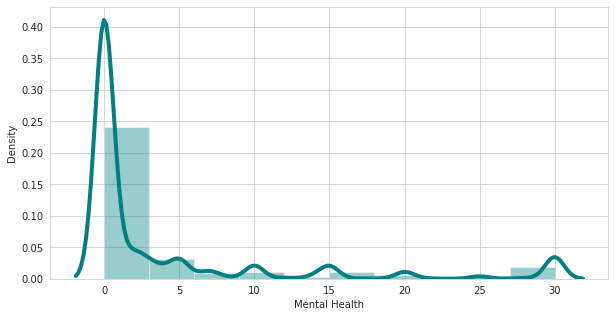

In [ ]:
sns.set_style("whitegrid") 
plt.figure(figsize = (10,5)) 
p=sns.distplot(x = data.MentalHealth  ,  bins = 10 , kde = True , color = 'teal'\
             , kde_kws=dict(linewidth = 4 , color = 'teal'))
p.set_xlabel("Mental Health")

plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


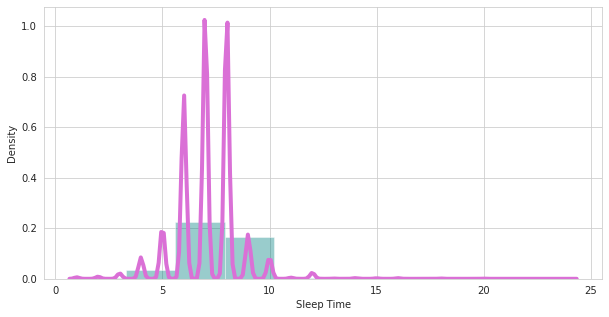

In [ ]:
sns.set_style("whitegrid") 
plt.figure(figsize = (10,5)) 
p=sns.distplot(x = data.SleepTime  ,  bins = 10 , kde = True , color = 'teal'\
             , kde_kws=dict(linewidth = 4 , color = 'orchid'))
p.set_xlabel("Sleep Time")

plt.show()

In [ ]:
sns.set_style("whitegrid") 
plt.figure(figsize = (10,5)) 
sns.distplot(x = data.BMI  ,  bins = 10 , kde = True , color = 'teal'\
             , kde_kws=dict(linewidth = 4 , color = 'black'))
plt.show()

#### Обработка на категориските карактеристики

 
----------------------------------------------------------------------
 
     HeartDisease      Ratio
No         292422  91.440454
Yes         27373   8.559546
 
 


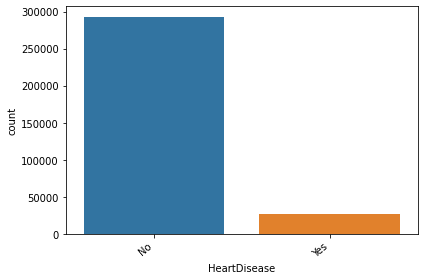

 
----------------------------------------------------------------------
 
     Smoking      Ratio
No    187887  58.752326
Yes   131908  41.247674
 
 


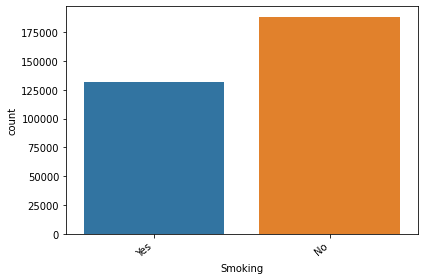

 
----------------------------------------------------------------------
 
     AlcoholDrinking      Ratio
No            298018  93.190325
Yes            21777   6.809675
 
 


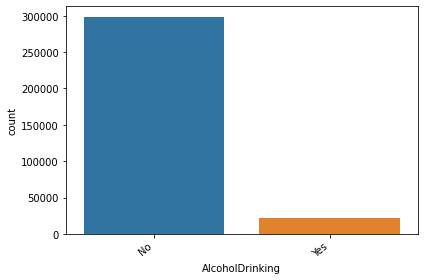

 
----------------------------------------------------------------------
 
     Stroke     Ratio
No   307726  96.22602
Yes   12069   3.77398
 
 


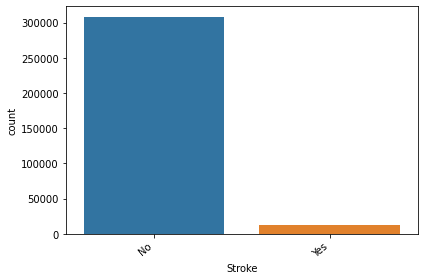

 
----------------------------------------------------------------------
 
     DiffWalking      Ratio
No        275385  86.112979
Yes        44410  13.887021
 
 


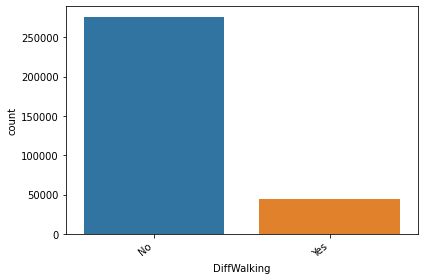

 
----------------------------------------------------------------------
 
           Sex      Ratio
Female  167805  52.472678
Male    151990  47.527322
 
 


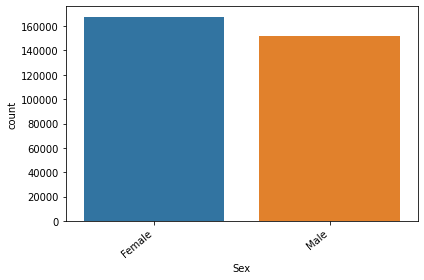

 
----------------------------------------------------------------------
 
             AgeCategory      Ratio
65-69              34151  10.679029
60-64              33686  10.533623
70-74              31065   9.714036
55-59              29757   9.305024
50-54              25382   7.936960
80 or older        24153   7.552651
45-49              21791   6.814053
75-79              21482   6.717428
18-24              21064   6.586720
40-44              21006   6.568583
35-39              20550   6.425992
30-34              18753   5.864069
25-29              16955   5.301834
 
 


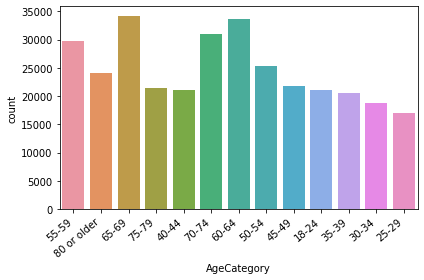

 
----------------------------------------------------------------------
 
                                  Race      Ratio
White                           245212  76.677872
Hispanic                         27446   8.582373
Black                            22939   7.173033
Other                            10928   3.417189
Asian                             8068   2.522866
American Indian/Alaskan Native    5202   1.626667
 
 


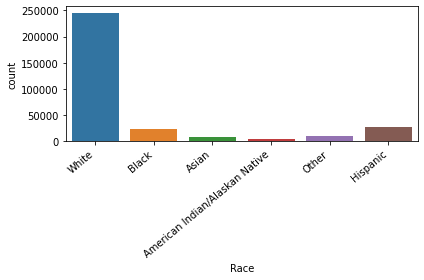

 
----------------------------------------------------------------------
 
                         Diabetic      Ratio
No                         269653  84.320580
Yes                         40802  12.758799
No, borderline diabetes      6781   2.120421
Yes (during pregnancy)       2559   0.800200
 
 


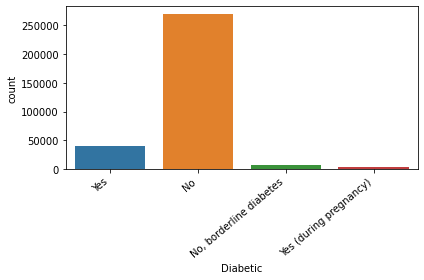

 
----------------------------------------------------------------------
 
     PhysicalActivity      Ratio
Yes            247957  77.536234
No              71838  22.463766
 
 


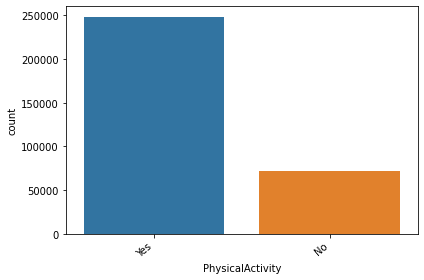

 
----------------------------------------------------------------------
 
           GenHealth      Ratio
Very good     113858  35.603433
Good           93129  29.121468
Excellent      66842  20.901515
Fair           34677  10.843509
Poor           11289   3.530074
 
 


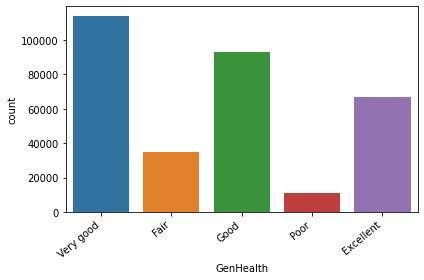

 
----------------------------------------------------------------------
 
     Asthma      Ratio
No   276923  86.593912
Yes   42872  13.406088
 
 


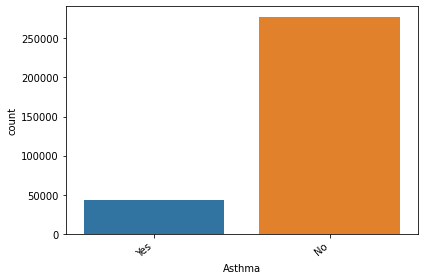

 
----------------------------------------------------------------------
 
     KidneyDisease      Ratio
No          308016  96.316703
Yes          11779   3.683297
 
 


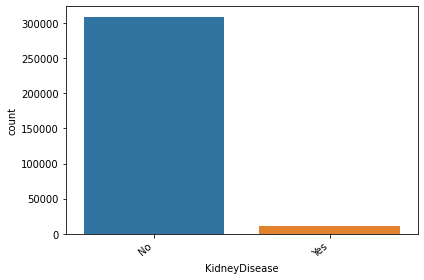

 
----------------------------------------------------------------------
 
     SkinCancer      Ratio
No       289976  90.675589
Yes       29819   9.324411
 
 


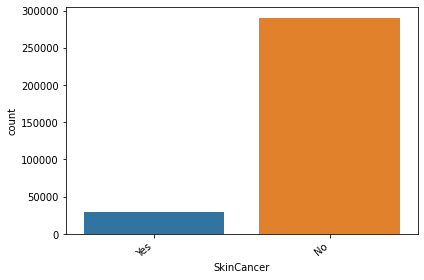

In [ ]:
def column_summary(data, columame):
    print(' ')
    print('----------------------------------------------------------------------')
    print(' ')
    print(pd.DataFrame({columame: data[columame].value_counts(),
                        "Ratio": 100 * data[columame].value_counts() / len(data)}))
    print(' ')
    print(' ')
    ax = sns.countplot(x=data[columame], data=data)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    plt.tight_layout()
    plt.show()
    
columns = [column for column in data.columns if data[column].dtypes == "O"]
for i in columns:
    column_summary(data, i)

In [ ]:
#koi se unikatni vrednosti za sekoja od kolonite
for column in columns:
    print('Unikatni vrednosti vo kolonata {}: {}'.format(column, data[column].unique()))

Unikatni vrednosti vo kolonata HeartDisease: ['No' 'Yes']
Unikatni vrednosti vo kolonata Smoking: ['Yes' 'No']
Unikatni vrednosti vo kolonata AlcoholDrinking: ['No' 'Yes']
Unikatni vrednosti vo kolonata Stroke: ['No' 'Yes']
Unikatni vrednosti vo kolonata DiffWalking: ['No' 'Yes']
Unikatni vrednosti vo kolonata Sex: ['Female' 'Male']
Unikatni vrednosti vo kolonata AgeCategory: ['55-59' '80 or older' '65-69' '75-79' '40-44' '70-74' '60-64' '50-54'
 '45-49' '18-24' '35-39' '30-34' '25-29']
Unikatni vrednosti vo kolonata Race: ['White' 'Black' 'Asian' 'American Indian/Alaskan Native' 'Other'
 'Hispanic']
Unikatni vrednosti vo kolonata Diabetic: ['Yes' 'No' 'No, borderline diabetes' 'Yes (during pregnancy)']
Unikatni vrednosti vo kolonata PhysicalActivity: ['Yes' 'No']
Unikatni vrednosti vo kolonata GenHealth: ['Very good' 'Fair' 'Good' 'Poor' 'Excellent']
Unikatni vrednosti vo kolonata Asthma: ['Yes' 'No']
Unikatni vrednosti vo kolonata KidneyDisease: ['No' 'Yes']
Unikatni vrednosti vo kol

#### За колоната Heart Disease

In [ ]:
print('Процент на лица кои имаат срцево заболување т.е срцеви проблеми: {:.4f}%'.format((len(data.HeartDisease[data.HeartDisease=='No']) / len(data)) * 100))
print('Процент на лица кои немаат срцево заболување т.е. срцеви проблеми: {:.4f}%'.format((len(data.HeartDisease[data.HeartDisease=='Yes']) / len(data)) * 100))

Процент на лица кои имаат срцево заболување т.е срцеви проблеми: 91.4405%
Процент на лица кои немаат срцево заболување т.е. срцеви проблеми: 8.5595%


In [ ]:
figure=px.pie(data_frame=data,names='HeartDisease',title='Лица со срцево заболување ',hole=0.5)
figure.show()

#### Сооднос на колоните Smoking  и Heart Desease

In [ ]:
peopleWhoAreSmoking=data[data['Smoking']=='Yes']
peopleWhoAreNotSmoking=data[data['Smoking']=='No']
figure=px.pie(data_frame=peopleWhoAreSmoking,names='HeartDisease',title='Дали луѓето кои се пушачи имаат срвево заболување?',hole=0.5)
figure.show()

In [ ]:
figure=px.pie(data_frame=peopleWhoAreNotSmoking,names='HeartDisease',title='Дали луѓето кои не се пушачи имаат срцево заболување?',hole=0.5)
figure.show()

#### Сооднос на колоните AlhoholDrinking и Heart Desease

In [ ]:
alcoholDrinkers=data[data['AlcoholDrinking']=='Yes']
NotAlcoholDrinkers=data[data['AlcoholDrinking']=='No']
figure=px.pie(data_frame=alcoholDrinkers,names='HeartDisease',title='Колку голем процент од луѓето кои конзумираат алкохол имаат срцево заболување?',hole=0.5)
figure.show()

In [ ]:
alcoholDrinkers=data[data['AlcoholDrinking']=='Yes']
NotAlcoholDrinkers=data[data['AlcoholDrinking']=='No']
figure=px.pie(data_frame=NotAlcoholDrinkers,names='HeartDisease',title='Колку голем процент од луѓето кои НЕ конзумираат алкохол имаат срвево заболување?',hole=0.5)
figure.show()

#### Сооднос на колоните Stroke и Heart Desease

In [ ]:
peopleWithStroke=data[data['Stroke']=='Yes']
peopleWithoutStroke=data[data['Stroke']=='No']
figure=px.pie(data_frame=peopleWithStroke,names='HeartDisease',title='Колку голем процент од луѓето доживеале мозочен удар, а имаат и срцево заболување?', hole=0.5)
figure.show()

In [ ]:
figure=px.pie(data_frame=peopleWithoutStroke,names='HeartDisease',title='Колку голем процент од луѓето кои НЕМААТ ДОЖИВЕАНО мозочен удар имаат срцево заболување?',hole=0.5)
figure.show()

#### Сооднос на колоните Physical Health и Heart Disease

In [ ]:
figure=px.box(data_frame=data,x='HeartDisease',y='PhysicalHealth')
figure.show()

#### Сооднос на колоните Mental Health и Heart Disease

In [ ]:
figure=px.box(data_frame=data,x='HeartDisease',y='MentalHealth')
figure.show()

#### Сооднос на колоните Difficalt Walking  и Heart Disease

In [ ]:
peopleWithDiffWalking=data[data['DiffWalking']=='Yes']
peopleWithoutDiffWalking=data[data['DiffWalking']=='No']
figure=px.pie(data_frame=peopleWithDiffWalking,names='HeartDisease',title='Колку голем процент од луѓето имаат проблеми со движењето, а притоа имаат и срцево заболување?',hole=0.5)
figure.show()

In [ ]:
figure=px.pie(data_frame=peopleWithoutDiffWalking,names='HeartDisease',title='Колку голем процет од луѓето НЕМААТ проблеми со движењето, а имаат срцево заболување?',hole=0.5)
figure.show()

#### Сооднос на колоните Sex и Heart Disease

In [ ]:
female=data[data['Sex']=='Female']
male=data[data['Sex']=='Male']
figure=px.pie(data_frame=female,names='HeartDisease',title='Колку голем процент од жените имаат срцево заболување?',hole=0.5)
figure.show()

In [ ]:
figure=px.pie(data_frame=male,names='HeartDisease',title='Колку голем процент од мажите имаат срцево заболување?',hole=0.5)
figure.show()

In [ ]:
#funkcija za konverzija na kolonite koi imaat dve vrednosti YES i NO vo binarni vrednosti t.e 1 i 0
#Yes = 1 , No=0
def convertColumnToBinary(column):
    data[column]=data[column].map(lambda x:1 if x=='Yes' else 0)
    return data[column]

#### Сооднос на колоните AgeCategory и HeartDesease

In [ ]:
data['HeartDisease']=convertColumnToBinary('HeartDisease')

In [ ]:
heartDeseasePercentageByAgeGroupnig=(data.groupby(['AgeCategory'])['HeartDisease'].mean()*100).round(2)
heartDeseasePercentageByAgeGroupnig

AgeCategory
18-24           0.62
25-29           0.78
30-34           1.21
35-39           1.44
40-44           2.31
45-49           3.41
50-54           5.45
55-59           7.40
60-64           9.88
65-69          12.01
70-74          15.60
75-79          18.85
80 or older    22.56
Name: HeartDisease, dtype: float64

In [ ]:
figure=px.bar(data_frame=heartDeseasePercentageByAgeGroupnig,x=heartDeseasePercentageByAgeGroupnig.index,y='HeartDisease',text_auto=True,title='Процент на срцеви заболувања во однос на старосната група')
figure.show()

#### Сооднос на колоните Diabetic и Heart Desease

In [ ]:
heartDeseasePercentageByDiabeticType=(data.groupby(['Diabetic'])['HeartDisease'].mean()*100).round(2)
heartDeseasePercentageByDiabeticType

Diabetic
No                          6.50
No, borderline diabetes    11.64
Yes                        21.95
Yes (during pregnancy)      4.22
Name: HeartDisease, dtype: float64

In [ ]:
figure=px.bar(data_frame=heartDeseasePercentageByDiabeticType,x=heartDeseasePercentageByDiabeticType.index,y='HeartDisease',text_auto=True,title='Процент на срцеви заболувања во однос на имањето и видот на дијабетис')
figure.show()

#### Сооднос на колоните Pysical Activity и Heart Desease

In [ ]:
heartDeseasePercentageByPhysicalActivity=(data.groupby(['PhysicalActivity'])['HeartDisease'].mean()*100).round(2)
heartDeseasePercentageByPhysicalActivity

PhysicalActivity
No     13.76
Yes     7.05
Name: HeartDisease, dtype: float64

In [ ]:
figure=px.bar(data_frame=heartDeseasePercentageByPhysicalActivity,x=heartDeseasePercentageByPhysicalActivity.index,y='HeartDisease',text_auto=True,title='Процент на луќето кои се физички активни/неактивни а имаат срцево заболување')
figure.show()

#### Сооднос на колоните SleepTime и Heart Desease

In [ ]:
heartDeseasePercentageBySleepTime=(data.groupby(['SleepTime'])['HeartDisease'].mean()*100).round(2)
heartDeseasePercentageBySleepTime

SleepTime
1.0     10.89
2.0     16.24
3.0     17.42
4.0     15.23
5.0     10.58
6.0      8.13
7.0      6.47
8.0      8.56
9.0     10.57
10.0    14.94
11.0    17.59
12.0    18.87
13.0    18.56
14.0    17.70
15.0    12.70
16.0    14.41
17.0     9.52
18.0    20.59
19.0    33.33
20.0    25.00
21.0     0.00
22.0    33.33
23.0     0.00
24.0    20.00
Name: HeartDisease, dtype: float64

In [ ]:
figure=px.bar(data_frame=heartDeseasePercentageBySleepTime,x=heartDeseasePercentageBySleepTime.index,y='HeartDisease',text_auto=True,title='Процент на луѓето кои имаат срцево заболување во однос на бројот на часови поминати во спиење во текот на еден ден')
figure.show()

#### Сооднос на колоните Asthma и Heart Disease



In [ ]:
heartDeseasePercentageByAsthma=(data.groupby(['Asthma'])['HeartDisease'].mean()*100).round(2)
figure=px.bar(data_frame=heartDeseasePercentageByAsthma,x=heartDeseasePercentageByAsthma.index,y='HeartDisease',text_auto=True,title='Процент на луѓе кои имаат срцево заболување, а имаат/немаат астма.')
figure.show()

In [ ]:
heartDeseasePercentageByGenHealth=(data.groupby(['GenHealth'])['HeartDisease'].mean()*100).round(2)

figure=px.bar(data_frame=heartDeseasePercentageByGenHealth,x=heartDeseasePercentageByGenHealth.index,y='HeartDisease',text_auto=True,title='Процент на луѓе кои имаат срцево заболување според генералното здравје')
figure.show()

#### Сооднос на колоните Kidney Disease и Heart Desease

In [ ]:
heartDeseasePercentageByKidneyDisease=(data.groupby(['KidneyDisease'])['HeartDisease'].mean()*100).round(2)

figure=px.bar(data_frame=heartDeseasePercentageByKidneyDisease,x=heartDeseasePercentageByKidneyDisease.index,y='HeartDisease',text_auto=True,title='Процент на луѓето кои имаат срцево заболување, а имаат/немаат заболување на бубрезите')
figure.show()

#### Сооднос на колоните Skin Cancer и Heart Desease

In [ ]:
heartDeseasePercentageBySkinCancer=(data.groupby(['SkinCancer'])['HeartDisease'].mean()*100).round(2)

figure=px.bar(data_frame=heartDeseasePercentageBySkinCancer,x=heartDeseasePercentageBySkinCancer.index,y='HeartDisease',text_auto=True,title='Процент на луѓето кои имаат срцево заболување, а имаат/немаат рак на кожата')
figure.show()

#### Сооднос на колоните Race и Heart Disease

In [ ]:
heartDeseasePercentageByRace=(data.groupby(['Race'])['HeartDisease'].mean()*100).round(2)
figure=px.bar(data_frame=heartDeseasePercentageByRace,x=heartDeseasePercentageByRace.index,y='HeartDisease',text_auto=True,title='Процент на имањето на срцево заболување според расата на испитаниците.')
figure.show()

#### Сооднос на колоните со бројни вредности меѓусебно вклуќувајќи го и параметарот дали примерокот има/нема срцево заболување 

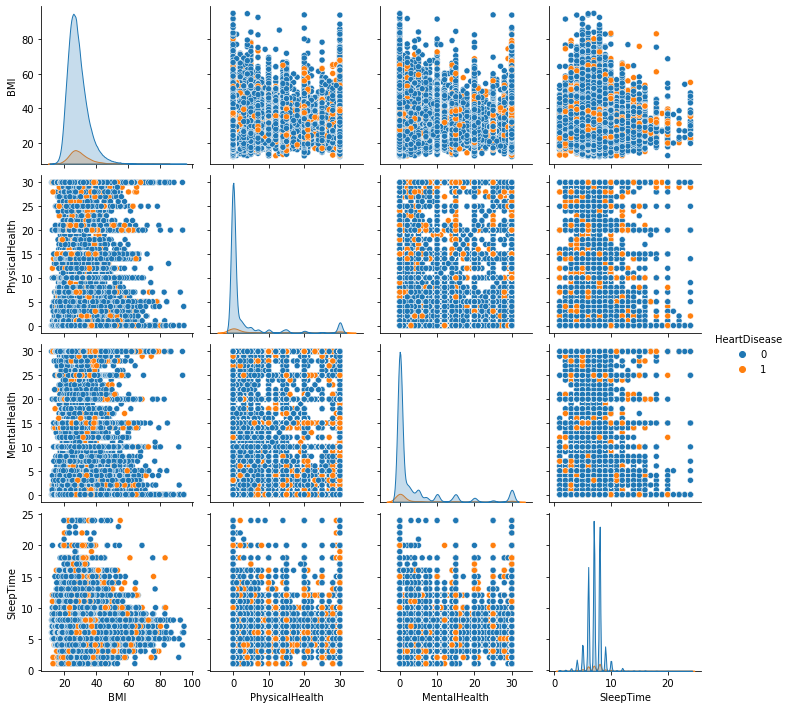

In [ ]:
sns.pairplot(data, hue='HeartDisease');

## Матрица на корелација, обработка на колоните, визуелизација на дел од врските меѓу колоните

#### Конверзија на податоците од објекти во нумерички вредности се со цел да добиеме подобра матрица на корелација

In [ ]:
convertToNumericalValues = {'Female': 0, 'Male': 1, 'No':0, 'Yes' : 1, 'No, borderline diabetes': 0,  'Yes (during pregnancy)': 1, 'Very good' :2, 'Fair':0, 'Good':1, 'Poor':0, 'Excellent':2}
data.replace(convertToNumericalValues, inplace=True)

In [ ]:
data.head()

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
0,0,16.60,1,0,0,3.0,30.0,0,0,55-59,White,1,1,2,5.0,1,0,1
1,0,20.34,0,0,1,0.0,0.0,0,0,80 or older,White,0,1,2,7.0,0,0,0
2,0,26.58,1,0,0,20.0,30.0,0,1,65-69,White,1,1,1,8.0,1,0,0
3,0,24.21,0,0,0,0.0,0.0,0,0,75-79,White,0,0,1,6.0,0,0,1
4,0,23.71,0,0,0,28.0,0.0,1,0,40-44,White,0,1,2,8.0,0,0,0


In [ ]:
data.info()
# за да провериме какви се податоците по конверзијата

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 319795 entries, 0 to 319794
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   HeartDisease      319795 non-null  int64  
 1   BMI               319795 non-null  float64
 2   Smoking           319795 non-null  int64  
 3   AlcoholDrinking   319795 non-null  int64  
 4   Stroke            319795 non-null  int64  
 5   PhysicalHealth    319795 non-null  float64
 6   MentalHealth      319795 non-null  float64
 7   DiffWalking       319795 non-null  int64  
 8   Sex               319795 non-null  int64  
 9   AgeCategory       319795 non-null  object 
 10  Race              319795 non-null  object 
 11  Diabetic          319795 non-null  int64  
 12  PhysicalActivity  319795 non-null  int64  
 13  GenHealth         319795 non-null  int64  
 14  SleepTime         319795 non-null  float64
 15  Asthma            319795 non-null  int64  
 16  KidneyDisease     31

In [ ]:
heart_corr = data.corr()['HeartDisease']

In [ ]:
TITLE_SIZE = 20
TITLE_PAD = 15

LABEL_SIZE = 15
LABEL_PAD = 15

SEED = 0
BLUE = '#007af3'

#### Матрици на корелација

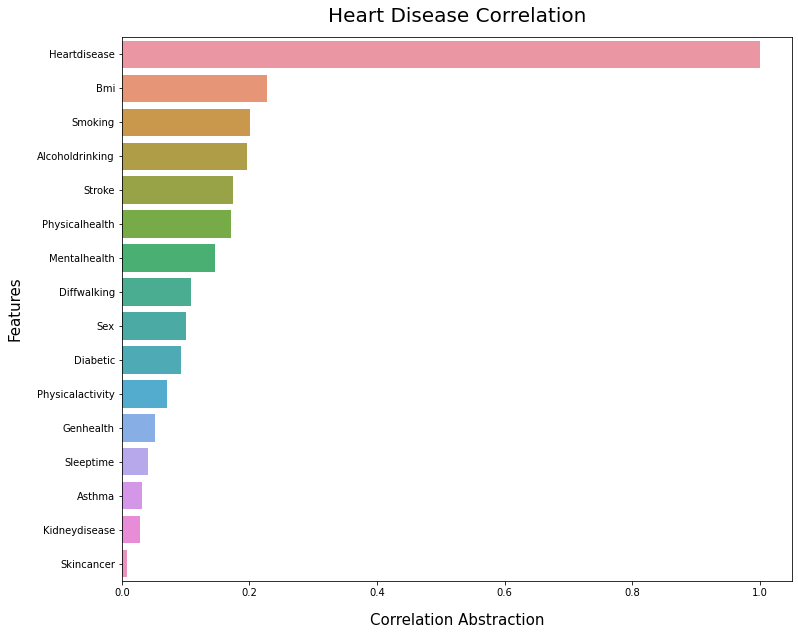

In [ ]:
fig, ax = plt.subplots(figsize=(12, 10))

sns.barplot(x=heart_corr.abs().sort_values(ascending=False), y=heart_corr.index)

ax.set_title('Heart Disease Correlation', fontsize=TITLE_SIZE, pad=TITLE_PAD)
ax.set_xlabel('Correlation Abstraction', fontdict={'fontsize': LABEL_SIZE}, labelpad=LABEL_PAD)
ax.set_ylabel('Features', fontdict={'fontsize': LABEL_SIZE}, labelpad=LABEL_PAD)
ax.yaxis.set_ticklabels(heart_corr.index.str.title())

plt.show()

In [ ]:
corr=data.corr()

In [ ]:
cmap = cmap=sns.diverging_palette(5, 250, as_cmap=True)

def magnify():
    return [dict(selector="th",
                 props=[("font-size", "7pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
]

corr.style.background_gradient(cmap, axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
    .set_caption("Correlation matrix")\
    .set_precision(2)\
    .set_table_styles(magnify())

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: FutureWarning:

this method is deprecated in favour of `Styler.format(precision=..)`



,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
HeartDisease,1.00,0.05,0.11,-0.03,0.20,0.17,0.03,0.20,0.07,0.17,-0.10,-0.23,0.01,0.04,0.15,0.09
BMI,0.05,1.00,0.02,-0.04,0.02,0.11,0.06,0.18,0.03,0.20,-0.15,-0.21,-0.05,0.09,0.05,-0.03
Smoking,0.11,0.02,1.00,0.11,0.06,0.12,0.09,0.12,0.09,0.06,-0.10,-0.16,-0.03,0.02,0.03,0.03
AlcoholDrinking,-0.03,-0.04,0.11,1.00,-0.02,-0.02,0.05,-0.04,0.00,-0.06,0.02,0.03,-0.01,-0.00,-0.03,-0.01
Stroke,0.20,0.02,0.06,-0.02,1.00,0.14,0.05,0.17,-0.00,0.10,-0.08,-0.16,0.01,0.04,0.09,0.05
PhysicalHealth,0.17,0.11,0.12,-0.02,0.14,1.00,0.29,0.43,-0.04,0.15,-0.23,-0.44,-0.06,0.12,0.14,0.04
MentalHealth,0.03,0.06,0.09,0.05,0.05,0.29,1.00,0.15,-0.10,0.03,-0.10,-0.22,-0.12,0.11,0.04,-0.03
DiffWalking,0.20,0.18,0.12,-0.04,0.17,0.43,0.15,1.00,-0.07,0.21,-0.28,-0.38,-0.02,0.10,0.15,0.06
Sex,0.07,0.03,0.09,0.00,-0.00,-0.04,-0.10,-0.07,1.00,-0.00,0.05,0.02,-0.02,-0.07,-0.01,0.01
Diabetic,0.17,0.20,0.06,-0.06,0.10,0.15,0.03,0.21,-0.00,1.00,-0.14,-0.25,0.00,0.05,0.15,0.03


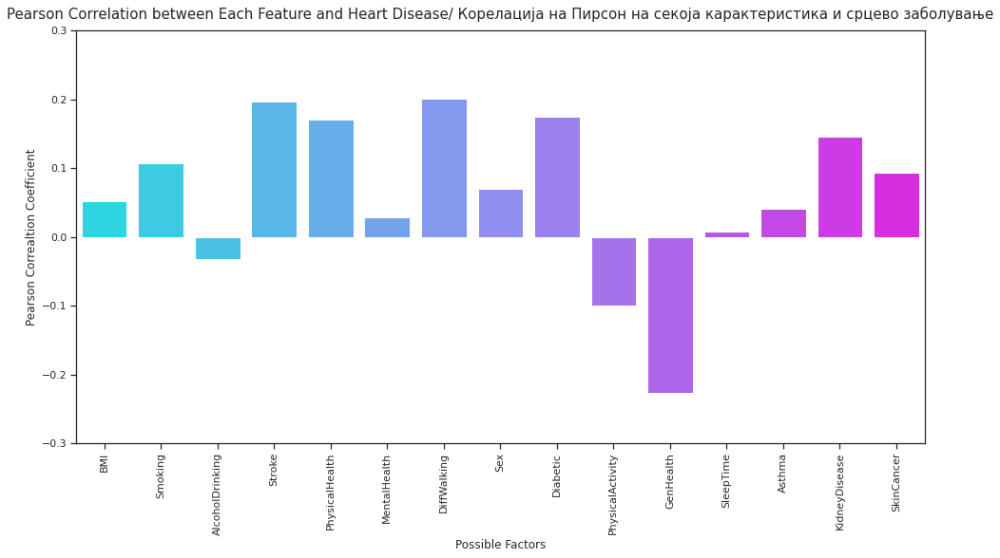

In [ ]:
# Pearson Correlation pomegju site karakteristiki i srcevoto zaboluvanje
data_corr = data.corr()
corr_ft_hd_x = list(data_corr.columns)
del corr_ft_hd_x[0]
corr_ft_hd_y = list(data_corr["HeartDisease"])
del corr_ft_hd_y[0]

corr_ft_hd = plt.figure(figsize= (16, 8))
corr_ft_hd = sns.barplot(x= corr_ft_hd_x, y= corr_ft_hd_y, palette= "cool")
corr_ft_hd.set_title("Pearson Correlation between Each Feature and Heart Disease/ Корелација на Пирсон на секоја карактеристика и срцево заболување",
                     fontsize= 15, pad= 12)
corr_ft_hd.set(xlabel= "Possible Factors",
               ylabel= "Pearson Correaltion Coefficient",
               ylim= (-0.3, 0.3))
corr_ft_hd.set_xticklabels(corr_ft_hd_x, rotation= "vertical")

plt.show()

#### Сооднос на сите колони од податочното множество меѓусебно, вклучувајќи го и параметраот за постоење на срцево заболување

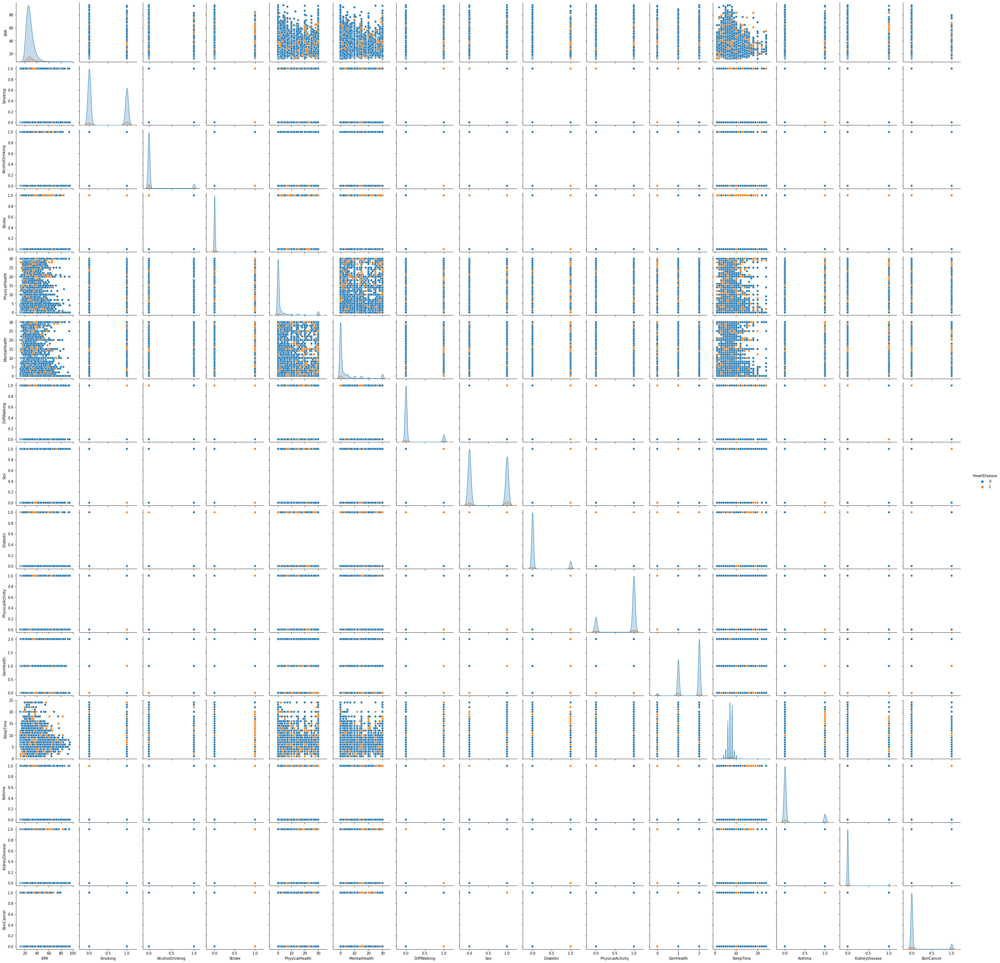

In [ ]:
sns.pairplot(data, hue='HeartDisease');

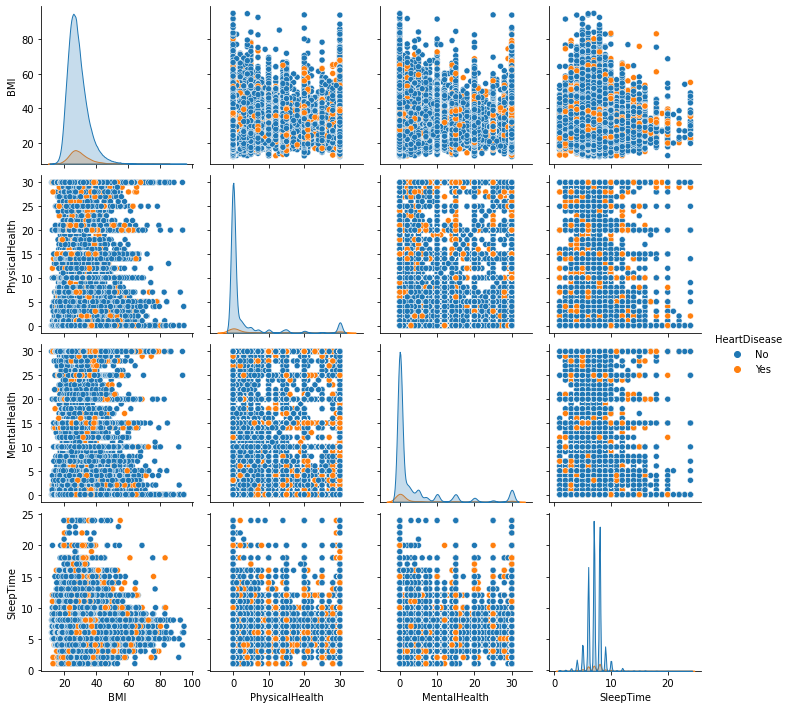

In [ ]:
sns.pairplot(data, hue='HeartDisease');

#### Рагледување на одосот на колоната BMI во одос со колоните за срево заболување, часови на спиење, физичка активност


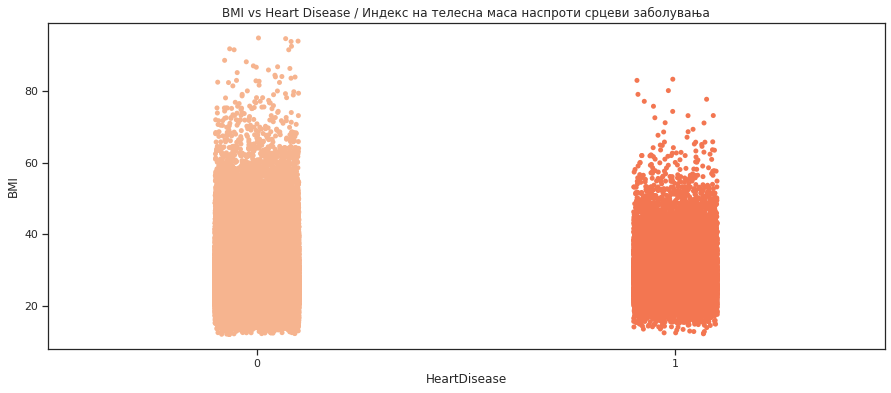

In [ ]:
sns.set_palette('rocket_r')
plt.figure(figsize=(15, 6))
sns.stripplot(data=data, x='HeartDisease', y='BMI',dodge=True)
plt.title('BMI vs Heart Disease / Индекс на телесна маса наспроти срцеви заболувања')
plt.xlabel('HeartDisease')
plt.ylabel('BMI')
plt.show()

In [ ]:
data['BMI'].describe([.25,0.50,.70,.80,.95,.97,.99])

count    319795.000000
mean         28.325399
std           6.356100
min          12.020000
25%          24.030000
50%          27.340000
70%          30.410000
80%          32.690000
95%          40.180000
97%          42.910000
99%          48.660000
max          94.850000
Name: BMI, dtype: float64

array([ 5.,  7.,  8.,  6., 12.,  4.,  9., 10., 15.,  3.,  2.,  1., 16.,
       18., 14., 20., 11., 13., 17., 24., 19., 21., 22., 23.])

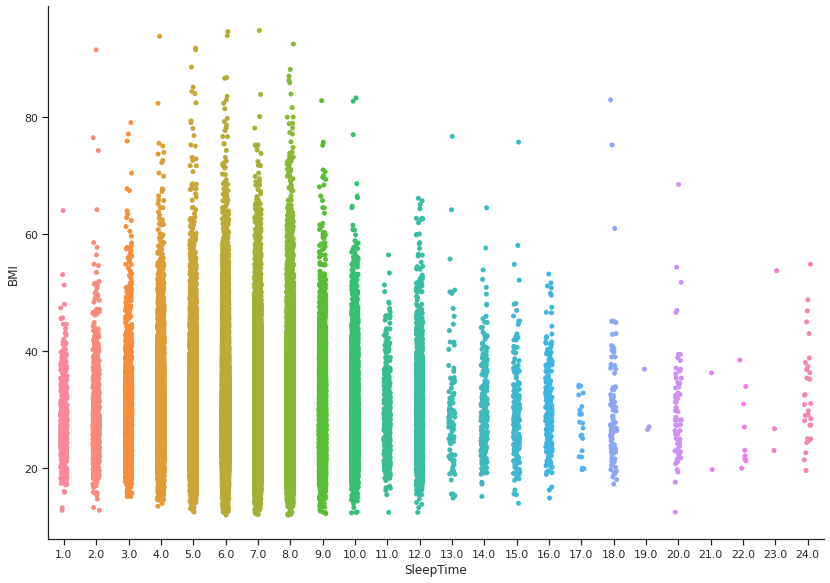

In [ ]:

sns.set_theme(style="ticks", color_codes=True)
sns.catplot(x="SleepTime", y="BMI", data=data,height=8.27, aspect=11.7/8.27)

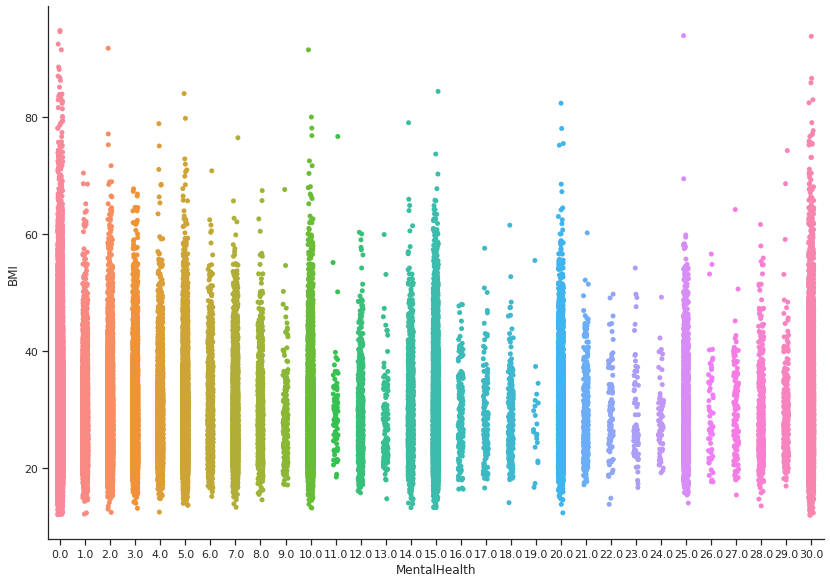

In [ ]:
sns.set_theme(style="ticks", color_codes=True)
sns.catplot(x="MentalHealth", y="BMI", data=data,height=8.27, aspect=11.7/8.27)

####Графички прикази на колони од интерес

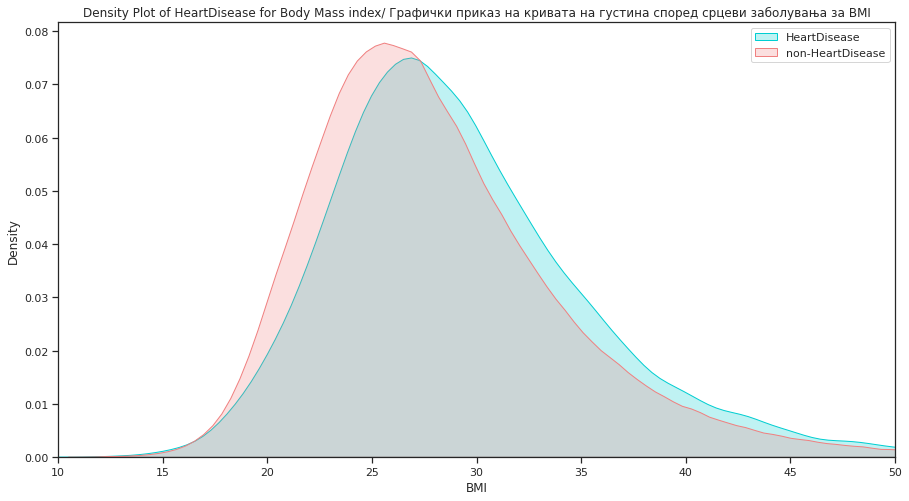

In [ ]:
plt.figure(figsize=(15,8))
ax = sns.kdeplot(data["BMI"][data.HeartDisease == 1], color="darkturquoise", shade=True)
sns.kdeplot(data["BMI"][data.HeartDisease == 0], color="lightcoral", shade=True)
plt.legend(['HeartDisease', 'non-HeartDisease'])
plt.title('Density Plot of HeartDisease for Body Mass index/ Графички приказ на кривата на густина според срцеви заболувања за BMI')
ax.set(xlabel='BMI')
plt.xlim(10,50)
plt.show()

(2.0, 15.0)

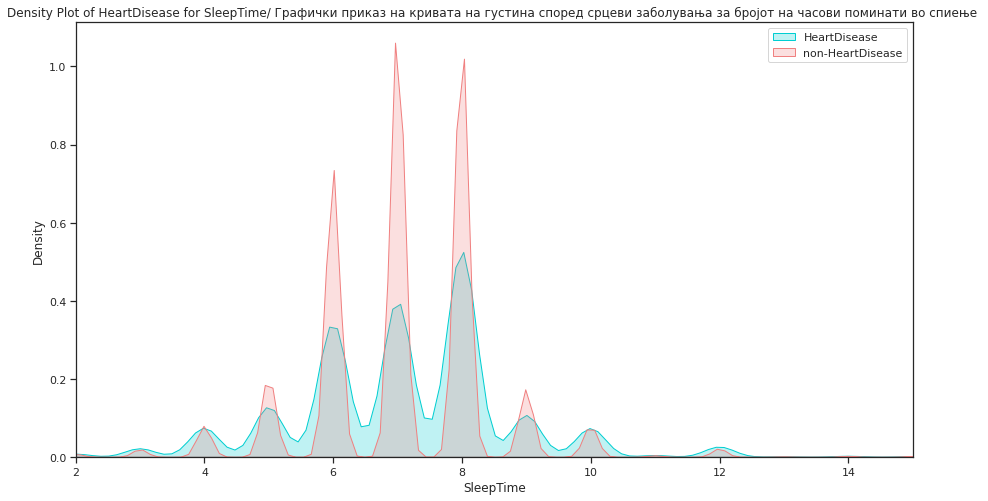

In [ ]:
plt.figure(figsize=(15,8))
ax = sns.kdeplot(data["SleepTime"][data.HeartDisease == 1], color="darkturquoise", shade=True)
sns.kdeplot(data["SleepTime"][data.HeartDisease == 0], color="lightcoral", shade=True)
plt.legend(['HeartDisease', 'non-HeartDisease'])
plt.title('Density Plot of HeartDisease for SleepTime/ Графички приказ на кривата на густина според срцеви заболувања за бројот на часови поминати во спиење ')
ax.set(xlabel='SleepTime')
plt.xlim(2,15)

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:670: UserWarning: Using the pointplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)
/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:675: UserWarning: Using the pointplot function without specifying `hue_order` is likely to produce an incorrect plot.
  warnings.warn(warning)


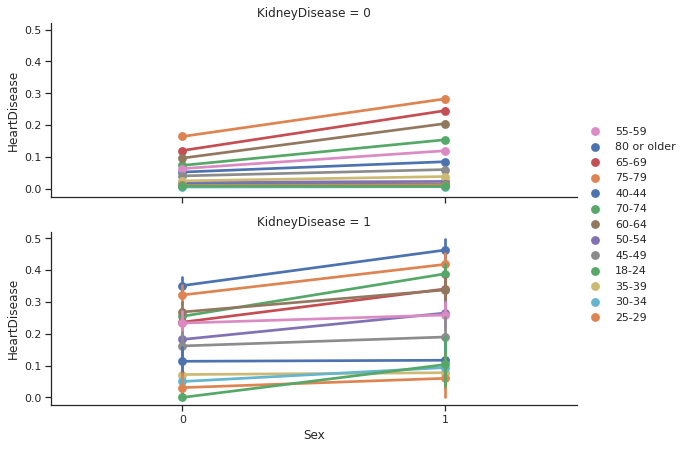

In [ ]:
grid = sns.FacetGrid(data, row='KidneyDisease', height=3.2, aspect=2.6)
grid.map(sns.pointplot, 'Sex', 'HeartDisease', 'AgeCategory', palette='deep',)
grid.add_legend()


/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:670: UserWarning:

Using the pointplot function without specifying `order` is likely to produce an incorrect plot.

/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:675: UserWarning:

Using the pointplot function without specifying `hue_order` is likely to produce an incorrect plot.



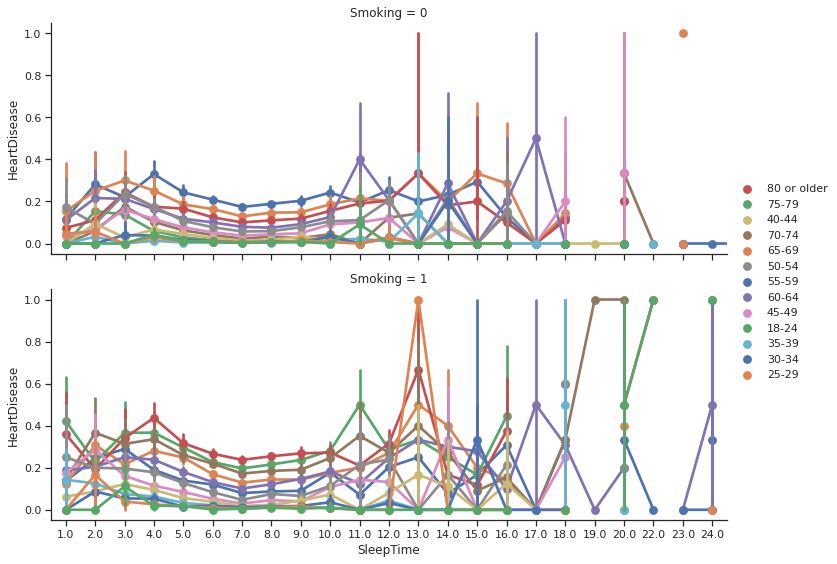

In [ ]:
grid = sns.FacetGrid(data, row='Smoking', height=4, aspect=2.6)
grid.map(sns.pointplot, 'SleepTime', 'HeartDisease', 'AgeCategory', palette='deep')
grid.add_legend()